In [6]:
#Importer les Librairies traitement image 
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import skimage


#importer les librairies utilitaires 
import pathlib
import math
import random

In [7]:
#chargement du dataset
images = [f for f in pathlib.Path('ds/misc').iterdir()]

print(len(images))

39


C:\Users\adril\AppData\Local\Temp\ipykernel_9516\271000713.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


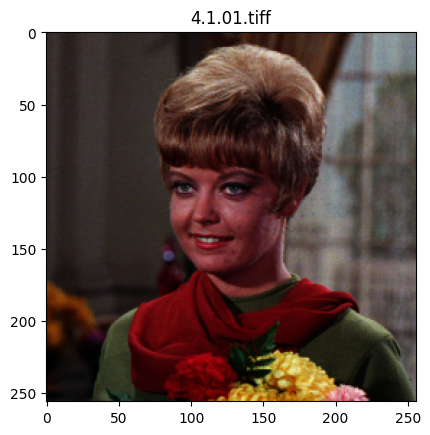

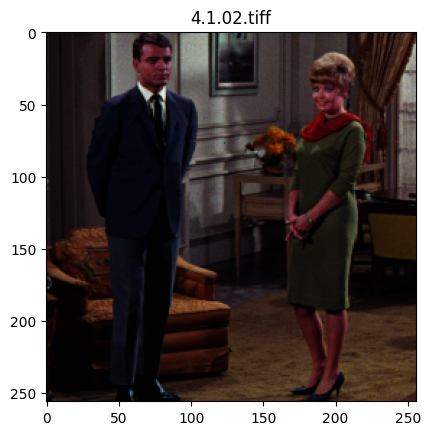

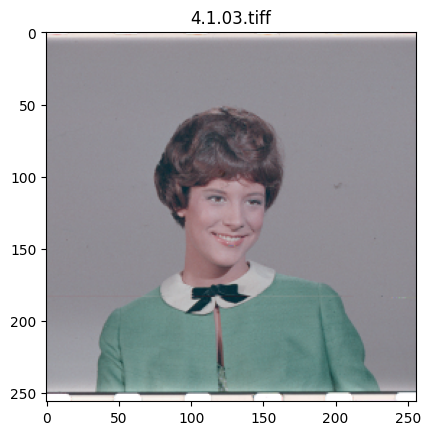

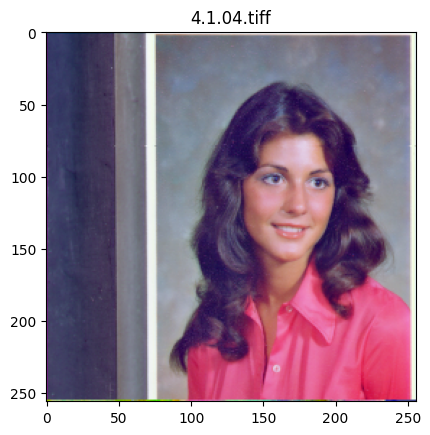

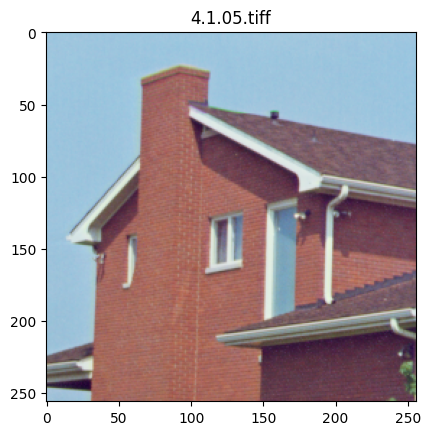

...

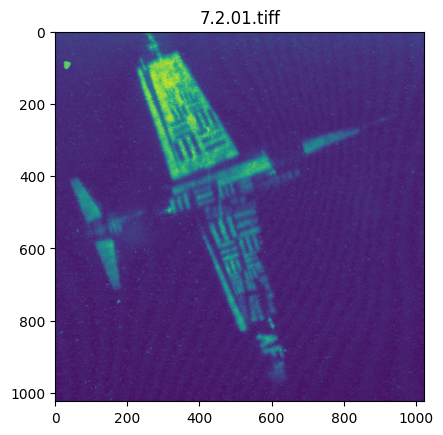

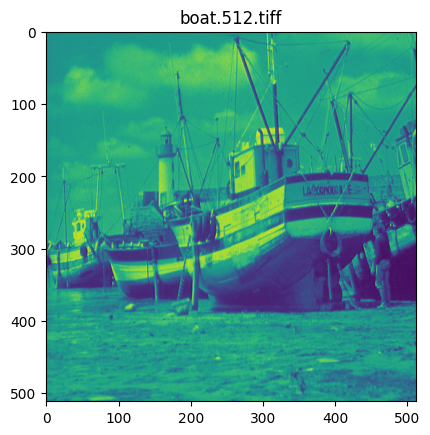

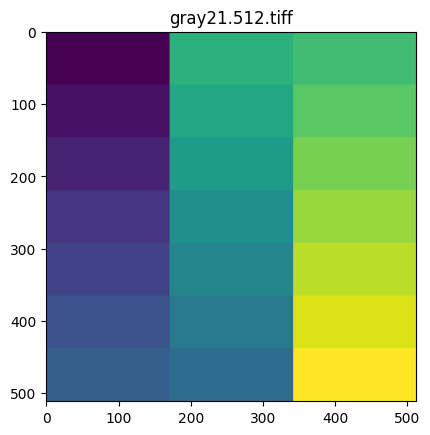

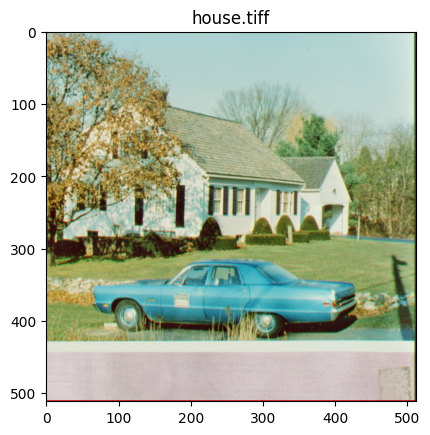

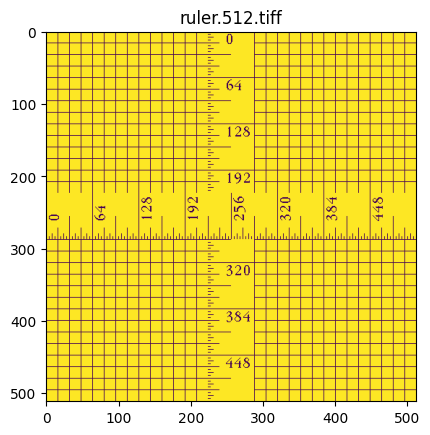

In [8]:
#Affichage des images chachune dans un plot différent
for img in images : 
    plt.figure()

    plt.title(img.name)

    img = plt.imread(img)

    plt.imshow(img)
    

13


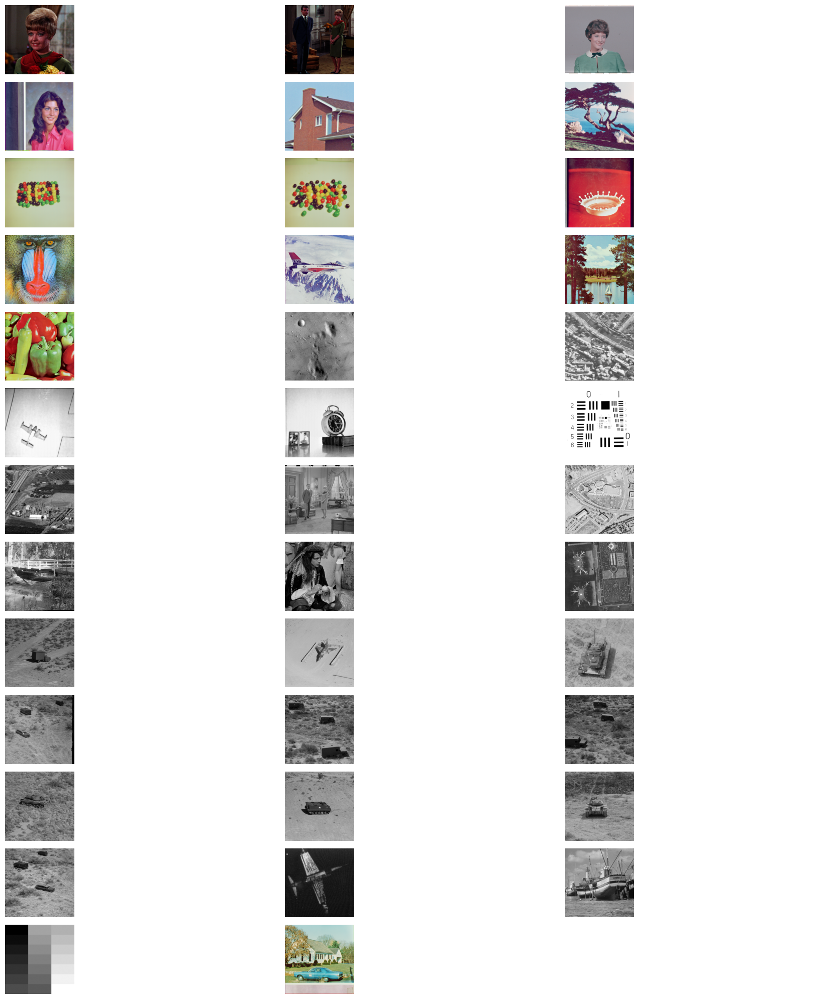

In [9]:
#Affichage de plusieurs images dans un même plot avec subplots
cols = 3 
rows = math.ceil((len(images)-1)/cols)
print(rows)

fig, axs = plt.subplots(nrows= rows, ncols = cols, figsize = (20,20), layout = 'tight')

for i, ax in enumerate(axs.flat):
    ax.set_axis_off()
    if i < len(images) -1 :
        img = plt.imread(images[i])

        if img.ndim < 3 :
            ax.imshow(img, cmap = plt.cm.gray)
        else:
            ax.imshow(img)

In [1]:
def chooseRandomImg():
    img = plt.imread(images[random.randint(0, len(images)-1)])
    
    return img

Text(0.5, 1.0, 'image downscale')

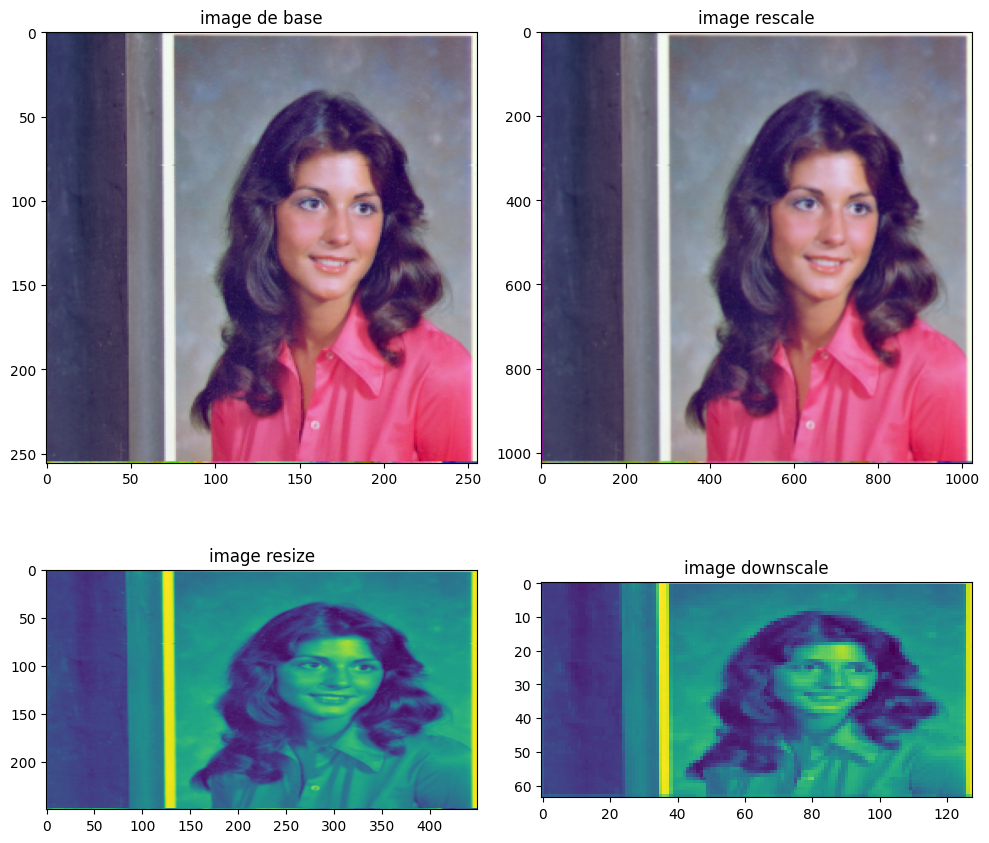

In [11]:
#Rescale, resize, downscale local mean 

img = chooseRandomImg()

img_rescale = skimage.transform.rescale(img, 4 , anti_aliasing = False, channel_axis=-1)
img_resize = skimage.transform.resize(img, (250,450,1), anti_aliasing=True)
img_downscale = skimage.transform.downscale_local_mean(img, (4, 2, 3))

fig, axs = plt.subplots(nrows = 2, ncols = 2, figsize= (10,10), layout= 'tight')

#for ax in axs.flat:
    #ax.set_axis_off()

axs[0,0].imshow(img)
axs[0,0].set_title('image de base')

axs[0,1].imshow(img_rescale)
axs[0,1].set_title('image rescale')

axs[1,0].imshow(img_resize)
axs[1,0].set_title('image resize')

axs[1,1].imshow(img_downscale)
axs[1,1].set_title('image downscale')

Text(0.5, 1.0, 'Image de croppé')

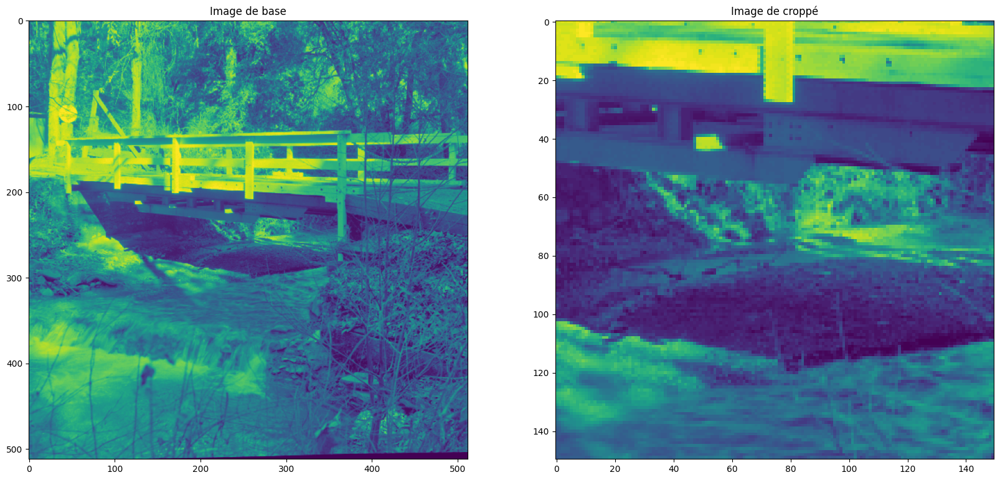

In [12]:
#Cropper les images
def center_crop(img, width = None, height = None):
    assert width or height, 'Précisez au moins une dimension'
    width = width or height
    height = height or width

    org_height, org_width = img.shape[:2] #(256, 185, 3)
    cropCenter_x, cropCenter_y = org_width// 2, org_height //2
    dimCrop_x, dimCrop_y = width // 2, height // 2

    return img[cropCenter_y-dimCrop_y : cropCenter_y + dimCrop_y, cropCenter_x-dimCrop_x : cropCenter_x + dimCrop_x] #[80, 250, :, :]

img = chooseRandomImg()

cropped_img = center_crop(img, 150)

fig, axs = plt.subplots(ncols = 2, nrows = 1, figsize = (20,20))

axs[0].imshow(img)
axs[0].set_title('Image de base')

axs[1].imshow(cropped_img)
axs[1].set_title('Image de croppé')

Text(0.5, 1.0, 'Image en N&B')

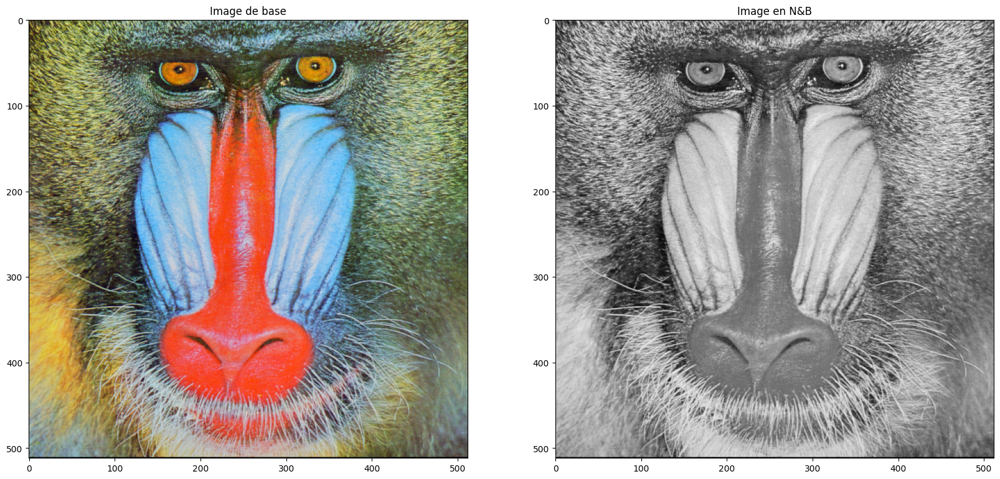

In [13]:
#Passage en grayscale

img = chooseRandomImg()

img_NB = skimage.color.rgb2gray(img)

fig, axs = plt.subplots(ncols = 2, nrows = 1, figsize = (20,20))

axs[0].imshow(img)
axs[0].set_title('Image de base')

axs[1].imshow(img_NB, cmap = plt.cm.gray)
axs[1].set_title('Image en N&B')


In [14]:
#Teinture image en N&B
img = chooseRandomImg()

img_NB = skimage.color.rgb2gray(img)
img_Tint = skimage.color.gray2rgb(img_NB)

r_multiplier = [1, 0, 0]
g_multiplier = [0, 1, 0]

img_Tint *= (r_multiplier)

fig, axs = plt.subplots(ncols = 3, nrows = 1, figsize = (20,20))

axs[0].imshow(img)
axs[0].set_title('Image de base')

axs[1].imshow(img_NB, cmap = plt.cm.gray)
axs[1].set_title('Image en N&B')

axs[2].imshow(img_Tint)
axs[2].set_title('Image teinté')

ValueError: the input array must have size 3 along `channel_axis`, got (512, 512)

c:\Users\adril\Desktop\INFO Program\Traitement Image\.venv\Lib\site-packages\skimage\_shared\utils.py:445: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


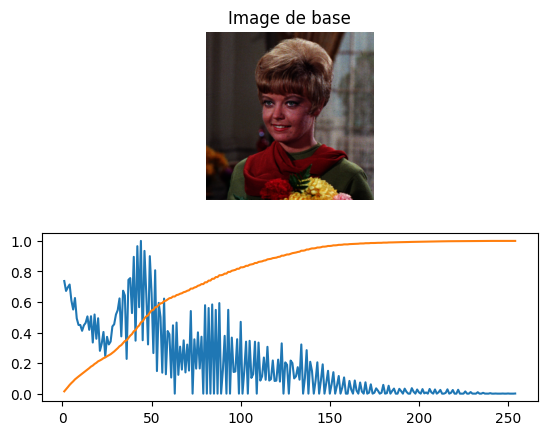

In [15]:
#Affichage d'un histogramme

img = chooseRandomImg()

img_histogram, bins = skimage.exposure.histogram(img)
img_cumul, cumulBins = skimage.exposure.cumulative_distribution(img)

fig, axs = plt.subplots(ncols = 1, nrows = 2)

axs[0].imshow(img)
axs[0].set_axis_off()
axs[0].set_title('Image de base')

axs[1].plot(bins, img_histogram/img_histogram.max())
axs[1].plot(cumulBins, img_cumul)


Text(0.5, 1.0, 'image normalisee')

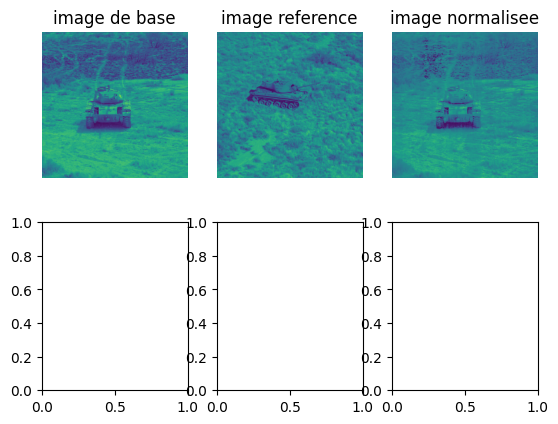

In [16]:
#Normalisation d'histogramme sur images Noir et blanc
img= chooseRandomImg()
img_ref= chooseRandomImg()
img_normalisee= skimage.exposure.match_histograms(img, img_ref, channel_axis= -1)

fig, axs=plt.subplots(ncols=3, nrows=2)

axs[0,0].imshow(img)
axs[0,0].set_axis_off()
axs[0,0].set_title('image de base')

axs[0,1].imshow(img_ref)
axs[0,1].set_axis_off()
axs[0,1].set_title('image reference')

axs[0,2].imshow(img_normalisee)
axs[0,2].set_axis_off()
axs[0,2].set_title('image normalisee')

In [17]:
#Normalisation d'histogramme sur images Noir et blanc
img= chooseRandomImg()
img_ref = chooseRandomImg()
img_normalisee= skimage.exposure.match_histograms(img, img_ref, channel_axis= -2)
img_histogram, bins = skimage.exposure.histogram(img)
img_cumul, cumulBins = skimage.exposure.cumulative_distribution(img)
imgRef_histogram, refbins = skimage.exposure.histogram(img_ref)
imgRef_cumul, cumulRefBins = skimage.exposure.cumulative_distribution(img_ref)
imgNorm_histogram, normBins = skimage.exposure.histogram(img_normalisee)
imgNorm_cumul, cumulNormBins = skimage.exposure.cumulative_distribution(img_normalisee)

fig, axs=plt.subplots(ncols=3,nrows=2, figsize=(12,12))

axs[0,0].imshow(img)
axs[0,0].set_axis_off()
axs[0,0].set_title('image de base')

axs[0,1].imshow(img_ref)
axs[0,1].set_axis_off()
axs[0,1].set_title('image référence')

axs[0,2].imshow(img_normalisee)
axs[0,2].set_axis_off()
axs[0,2].set_title('image normalisée')

axs[1,0].plot(bins, img_histogram/img_histogram.max())
axs[1,0].plot(cumulBins, img_cumul)
axs[1,1].plot(refbins, imgRef_histogram/imgRef_histogram.max())
axs[1,1].plot(cumulRefBins, imgRef_cumul)
axs[1,2].plot(normBins, imgNorm_histogram/imgNorm_histogram.max())
axs[1,2].plot(cumulNormBins, imgNorm_cumul)

ValueError: Number of channels in the input image and reference image must match!

In [ ]:
#Egalisation d'histogrammes par différentes techniques


def afficherImgHist(img, axes, bins=256):

    img = skimage.img_as_float(img)
    ax_img, ax_hist = axes  
    ax_cumul = ax_hist.twinx()

    #Affichage de l'image en N&B
    ax_img.imshow(img, cmap = plt.cm.gray)
    ax_img.set_axis_off()

    #Affichage de l'histogramme, setup des axes

    ax_hist.hist(img.ravel(),bins =bins, histtype= 'step', color= 'black')
    ax_hist.ticklabel_format(axis= 'y', style = 'scientific', scilimits=(0,0))
    ax_hist.set_xlabel('Valeur de pixels (de 0. à 1.)')
    ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    #Affichage de l'histogramme cumulatif
    img_cumul, bins = skimage.exposure.cumulative_distribution(img, bins)
    ax_cumul.plot(bins, img_cumul, 'r')
    ax_cumul.set_yticks([])

    return ax_img, ax_hist, ax_cumul

C:\Users\adril\AppData\Local\Temp\ipykernel_5696\1854590772.py:35: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


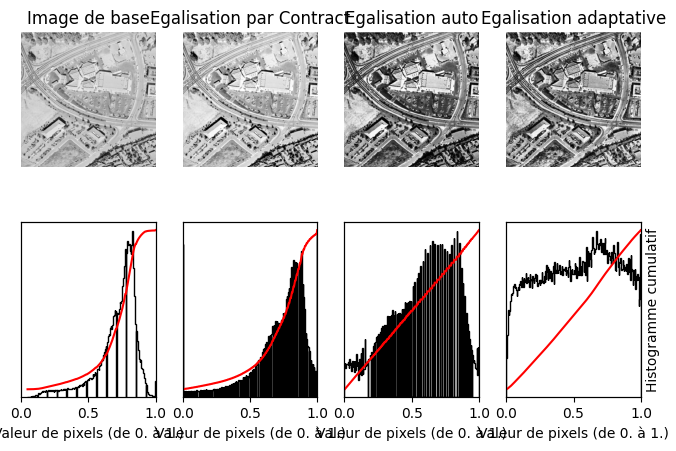

In [ ]:
#Egalisation par étirement du contraste
p2,p98=np.percentile(img,(2,98))#récupère les pixels dont les valeurs sont à 2 et 98%
img_stretch=skimage.exposure.rescale_intensity(img, in_range=(p2,p98))

#egalisation automatique
img_autoEq=skimage.exposure.equalize_hist(img)

#Egalisation adaptative
img_adapt=skimage.exposure.equalize_adapthist(img, clip_limit=0.03)

#Affichage des resultats
fig=plt.figure(figsize=(8,5))
axes=np.zeros((2,4),dtype=object)
axes[0,0]=fig.add_subplot(2,4,1)

for i in range(1,4):
    axes[0,i]=fig.add_subplot(2,4,1+i, sharex=axes[0,0], sharey=axes[0,0])
for i in range(0,4):
    axes[1,i]= fig.add_subplot(2,4,5+i)

ax_img,ax_hist, ax_cumul= afficherImgHist(img, axes[:,0])
ax_img.set_title('Image de base')

ax_img,ax_hist, ax_cumul= afficherImgHist(img_stretch, axes[:,1])
ax_img.set_title('Egalisation par Contract')

ax_img,ax_hist, ax_cumul= afficherImgHist(img_autoEq, axes[:,2])
ax_img.set_title('Egalisation auto')

ax_img,ax_hist, ax_cumul= afficherImgHist(img_adapt, axes[:,3])
ax_img.set_title('Egalisation adaptative')
ax_cumul.set_ylabel('Histogramme cumulatif')

fig.tight_layout
fig.show()

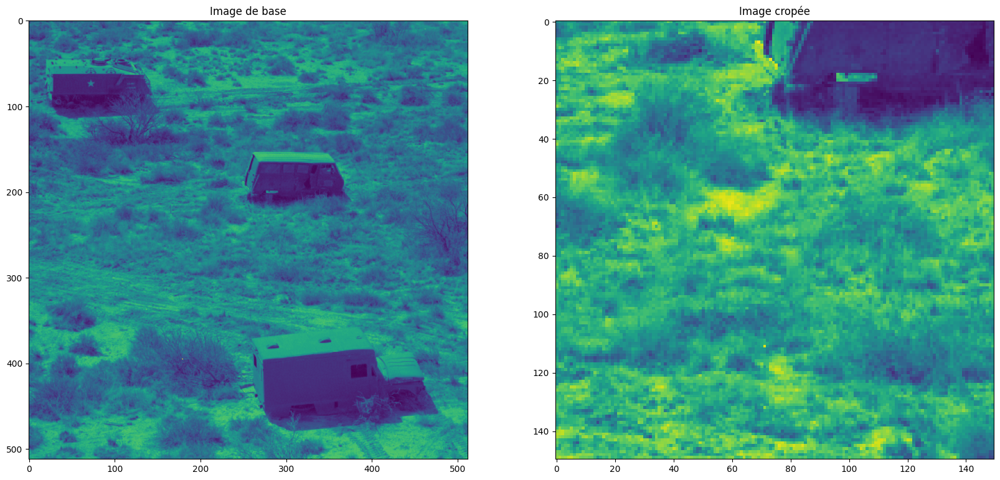

In [ ]:
#Cropper les images (zoomer les images)
def center_crop(img, width=None, height=None):
    assert width or height, 'Préciser au moins une dimension'
    width= width or height
    height= height or width

    org_height, org_width= img.shape[:2]
    cropCenter_x, cropCenter_y= org_width//2, org_height//2
    dimCrop_x, dimCrop_y=width//2, height//2

    return img[cropCenter_y-dimCrop_y: cropCenter_y+dimCrop_y, cropCenter_x-dimCrop_x: cropCenter_x+dimCrop_x]

img=chooseRandomImg()
cropped_img=center_crop(img,150)

fig, axs=plt.subplots(ncols=2, nrows=1,figsize=(20,20))
axs[0].imshow(img)
axs[0].set_title('Image de base')

axs[1].imshow(cropped_img)
axs[1].set_title('Image cropée')

def afficherImgHist(img, axes, bins=256):

    img= skimage.img_as_float(img)
    ax_img, ax_hist= axes
    ax_cumul= ax_hist.twinx()


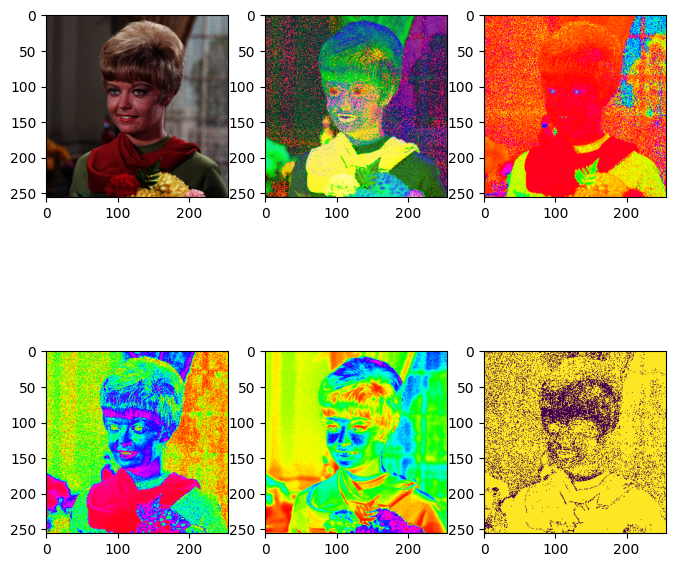

In [ ]:
#Passage en HSV et seuillage
img=chooseRandomImg()
hsv_img=skimage.color.rgb2hsv(img)
hue_img=hsv_img[:,:,0]
sat_img=hsv_img[:,:,1]
val_img=hsv_img[:,:,2]

hue_threshold=0.04
val_threshold=0.02
bin_img=(hue_img > hue_threshold ) | (val_img < val_threshold)

cols=3
rows=2

fig, axs=plt.subplots(nrows=2, ncols=3, figsize=(8,8))

axs[0,0].imshow(img)
axs[0,1].imshow(hsv_img)
axs[0,2].imshow(hue_img, cmap='hsv')
axs[1,0].imshow(sat_img, cmap='hsv')
axs[1,1].imshow(val_img, cmap='hsv')
axs[1,2].imshow(bin_img)

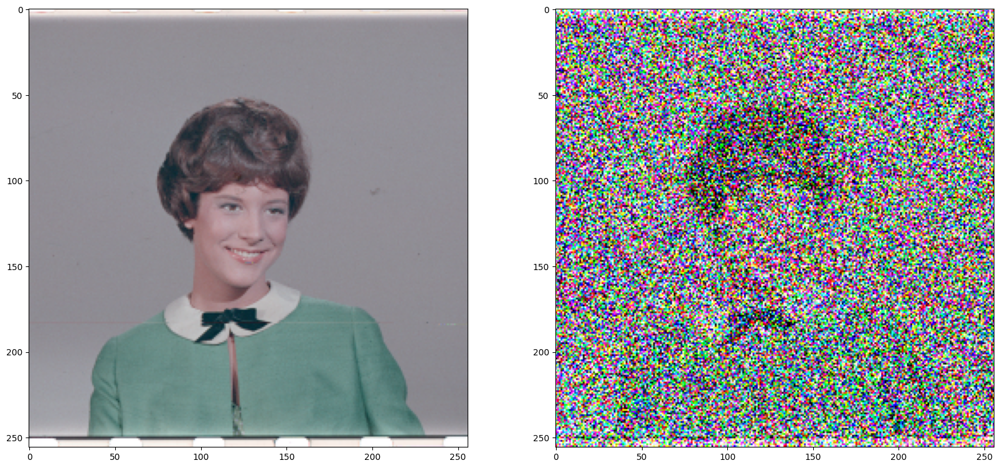

In [ ]:
##Ajout de bruit

img=chooseRandomImg()
noise_img= skimage.util.random_noise(img, var=0.5)

fig, axs = plt.subplots(nrows=1 , ncols=2 , figsize=(20,20))

axs[0].imshow(img)
axs[1].imshow(noise_img)

ImportError: PyWavelets is not installed. Please ensure it is installed in order to use this function.

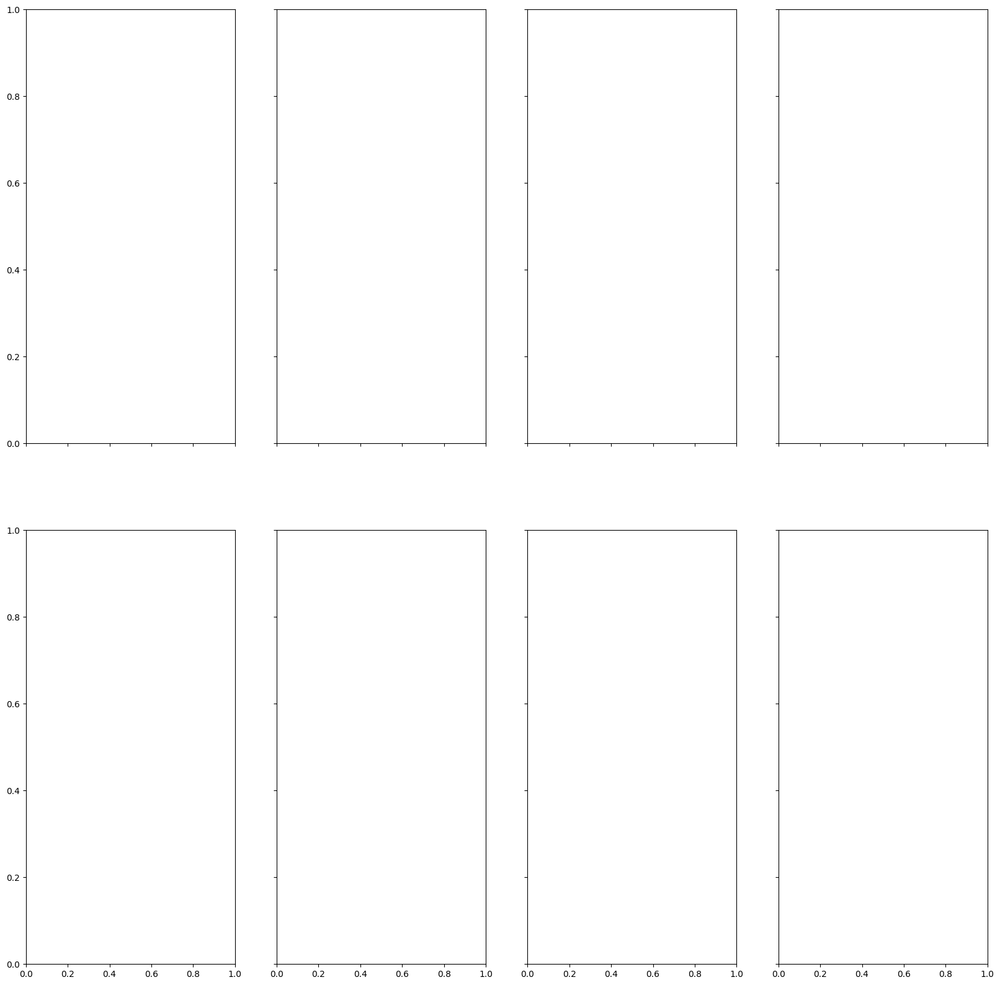

In [18]:

img=chooseRandomImg()

#setup de la variation de  bruit dans l'image
sigma=0.2
noisy=skimage.util.random_noise(img, var= sigma**2)

fig, ax=plt.subplots(nrows=2 , ncols=4 , figsize=(20,20), sharex=True, sharey=True)

dev_est=skimage.restoration.estimate_sigma(noisy, average_sigmas=True, channel_axis=-1)

ax[0,0].imshow(noisy)
ax[0,0].set_title('Image brutée')

#Débruitage par Total Variation
ax[0,1].imshow(skimage.restoration.denoise_tv_chambolle(noisy, weight=0.01, channel_axis=-1))
ax[0,1].set_title('Image brutée')

#Débruitage par Total Variation bilatéral
ax[0,2].imshow(skimage.restoration.denoise_bilateral(noisy,  channel_axis=-1, sigma_color=0.05, sigma_spatial=15))
ax[0,2].set_title('Image Bilatéral')


#Débruitage par wavelet
ax[0,3].imshow(skimage.restoration.denoise_wavelet(noisy, channel_axis=-1, rescale_sigma=True))
ax[0,3].set_title('wavelet ')

fig.tight_layout()

fig.show()


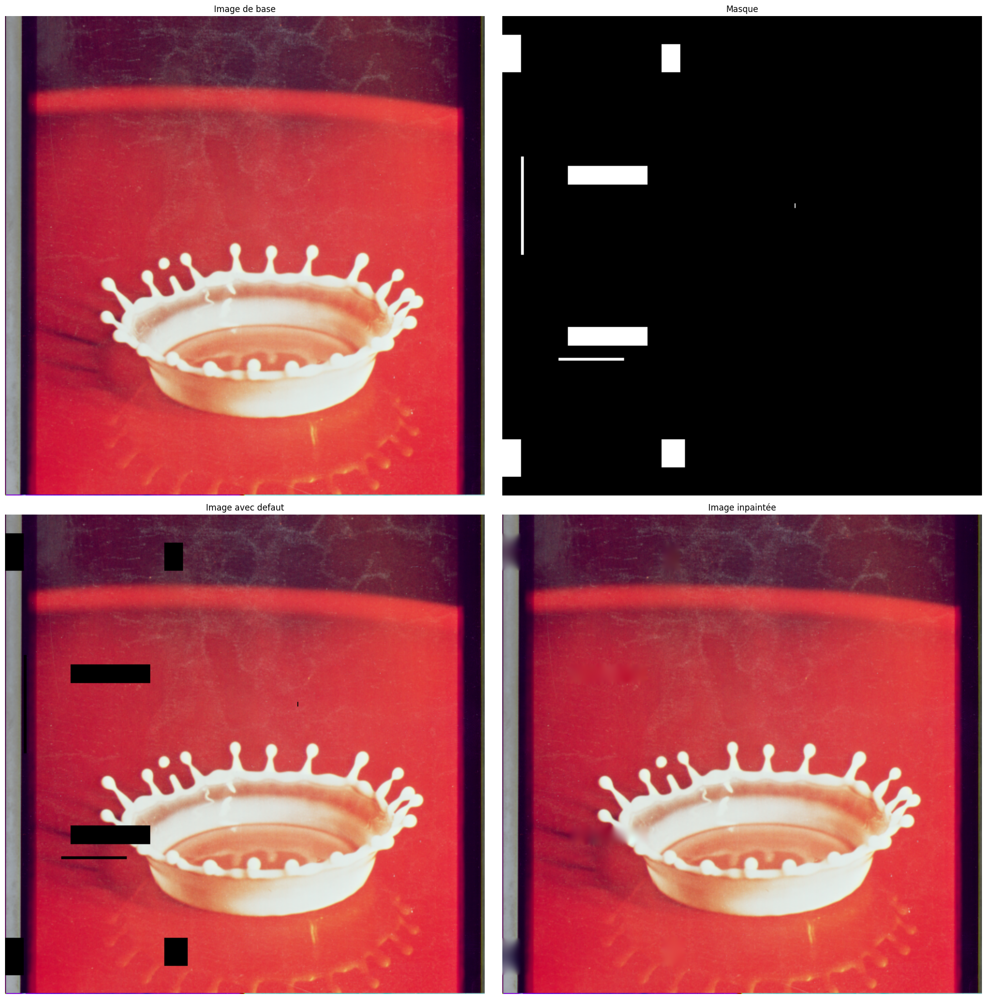

In [ ]:
##Répartition par inpainting
img=chooseRandomImg()

#Création d'un masque de defaut
mask=np.zeros(img.shape[:-1], dtype=bool)
mask[20:60, 0:20] = 1
mask[160:180, 70:155] = 1
mask[30:60, 170:190] = 1
mask[-60:-30, 170:195] = 1
mask[-180:-160, 70:155] = 1
mask[-60:-20, 0:20] = 1

#Création de longue bandes noires
mask[200:205, -200] = 1
mask[150:255, 20:23] = 1
mask[365:368, 60:130] = 1

#On applique les defaut
img_defect= img*~mask[..., np.newaxis]

img_result=skimage.restoration.inpaint_biharmonic(img_defect, mask,channel_axis=-1)

fig, axes=plt.subplots(ncols=2, nrows=2, figsize=(20,20))
ax=axes.ravel()

ax[0].imshow(img)
ax[0].set_title('Image de base')

ax[1].imshow(mask, cmap=plt.cm.gray)
ax[1].set_title('Masque')

ax[2].imshow(img_defect)
ax[2].set_title('Image avec defaut')
n
ax[3].imshow(img_result)
ax[3].set_title('Image inpaintée')

for a in ax:
    a.axis('off')

fig.tight_layout()
plt.show()